# Multi Linear Regression

Objective:

1) Predict the sales price of a house based on various inputs

2) Is it possible to improve the evaluation score obtained for (1) by creating some new columns?

In [1]:
# Import Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
# Step 1: Load the data
url = "https://bit.ly/316tYZT"
df = pd.read_csv(url)
df.head(5)

,Lot Area,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Gr Liv Area,Full Bath,Bedroom AbvGr,Fireplaces,Garage Cars,SalePrice
0,31770,6,5,1960,1960,1656,1,3,2,2,215000
1,11622,5,6,1961,1961,896,1,2,0,1,105000
2,14267,6,6,1958,1958,1329,1,3,0,1,172000
3,11160,7,5,1968,1968,2110,2,3,2,2,244000
4,13830,5,5,1997,1998,1629,2,3,1,2,189900


In [3]:
df.describe() # describes at a glance the statistical characteristics of the dataframe

,Lot Area,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Gr Liv Area,Full Bath,Bedroom AbvGr,Fireplaces,Garage Cars,SalePrice
count,2925.000000,2925.000000,2925.000000,2925.000000,2925.000000,2925.000000,2925.000000,2925.000000,2925.000000,2925.000000,2925.000000
mean,10103.583590,6.088205,5.563761,1971.302906,1984.234188,1493.978803,1.564786,2.853675,0.596923,1.764444,180411.574701
std,7781.999124,1.402953,1.112262,30.242474,20.861774,486.273646,0.551386,0.827737,0.645349,0.760405,78554.857286
min,1300.000000,1.000000,1.000000,1872.000000,1950.000000,334.000000,0.000000,0.000000,0.000000,0.000000,12789.000000
25%,7438.000000,5.000000,5.000000,1954.000000,1965.000000,1126.000000,1.000000,2.000000,0.000000,1.000000,129500.000000
50%,9428.000000,6.000000,5.000000,1973.000000,1993.000000,1441.000000,2.000000,3.000000,1.000000,2.000000,160000.000000
75%,11515.000000,7.000000,6.000000,2001.000000,2004.000000,1740.000000,2.000000,3.000000,1.000000,2.000000,213500.000000
max,215245.000000,10.000000,9.000000,2010.000000,2010.000000,3820.000000,4.000000,8.000000,4.000000,5.000000,625000.000000


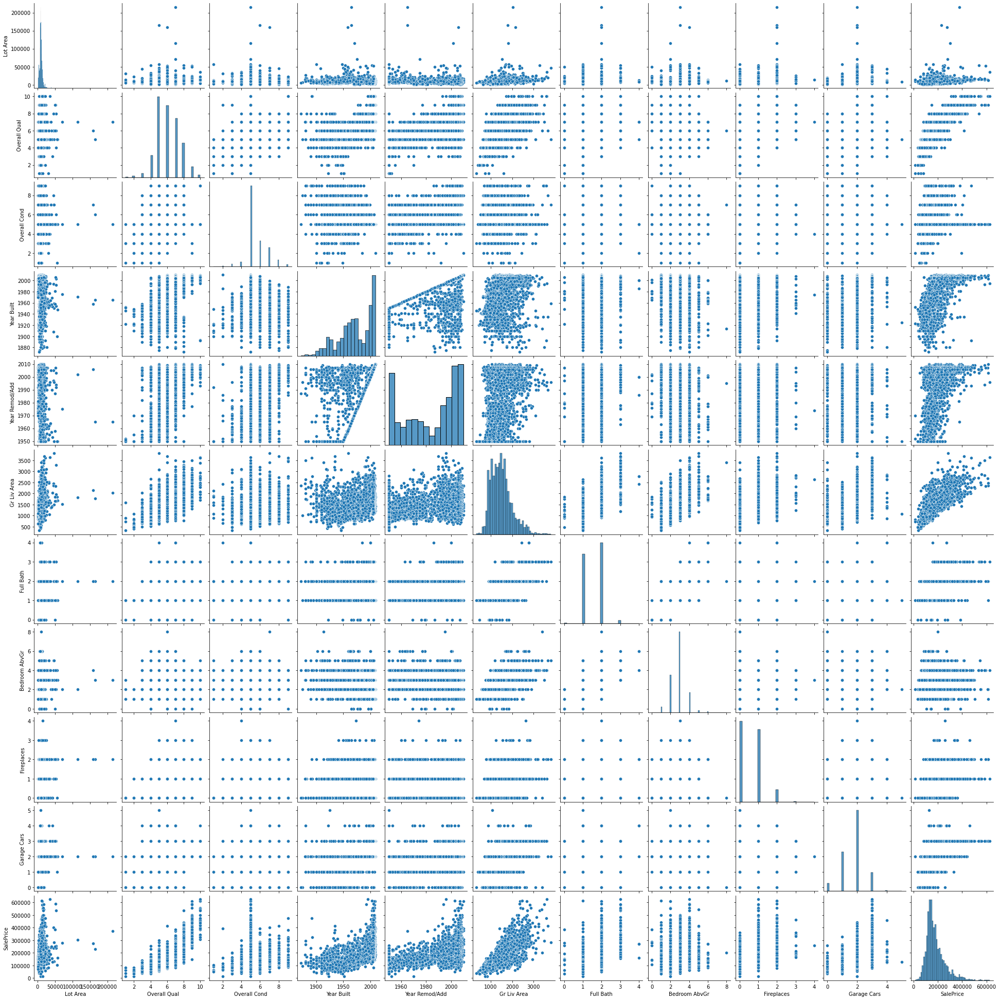

In [11]:
# Step 2: Check whether the one/more of the column pairs is/are suitable for Linear Regression (Uncomment and run on local to see)
import seaborn as sns # Visualization Library
sns.pairplot(df)

From the above plots, see which one is suitable for linear regression. For those that aren't suitable, either drop them or try transforming them.

In [5]:
# Import more libraries
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn import metrics

## Generic Function to Split Train Test

In [6]:
# Let's define a reusable function to split and train the model as and when required
def split_and_train(X, y):
    # Split data into train and test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=True)
    # Train the model
    lr_model = LinearRegression()
    lr_model.fit(X_train, y_train)

    pred = lr_model.predict(X_test)

    MAE = metrics.mean_absolute_error(y_test, pred)

    print("The Mean Absolute Error = ", MAE)

    MSE = metrics.mean_squared_error(y_test, pred)

    print("The Root Mean Squared Error = ", np.sqrt(MSE))

## Baseline Model and Results (All Columns)

In [7]:
# Step 3: Run the function against the dataset
X = df.drop('SalePrice', axis=1) # Drop SalePrice along the column
y = df['SalePrice'] # This is the output, iloc[:,col_index].values works as well

split_and_train(X, y)

The Mean Absolute Error =  24645.81800135277
The Root Mean Squared Error =  34287.013169419915


## Feature Engineering

In [8]:
X_fe = X.copy() # preserves original data
# Create 2 Interaction Terms
# 1) Overall Quality and Year Built --> New Column (Overall Quality * Year Built)
X_fe['OQ_YB'] = X_fe['Overall Qual'] * X_fe['Year Built']
# 2) Overall Quality and Lot Area ==> New Column (Overall Quality / Lot Area)
X_fe['OQ_LA'] = X_fe['Overall Qual'] / X_fe['Lot Area']

X_fe.tail(10)

,Lot Area,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Gr Liv Area,Full Bath,Bedroom AbvGr,Fireplaces,Garage Cars,OQ_YB,OQ_LA
2915,1894,4,5,1970,1970,1092,1,3,0,1,7880,0.002112
2916,12640,6,5,1976,1976,1728,2,4,0,2,11856,0.000475
2917,9297,5,5,1976,1976,1728,2,4,0,2,9880,0.000538
2918,17400,5,5,1977,1977,1126,2,3,1,2,9885,0.000287
2919,20000,5,7,1960,1996,1224,1,4,1,2,9800,0.000250
2920,7937,6,6,1984,1984,1003,1,3,0,2,11904,0.000756
2921,8885,5,5,1983,1983,902,1,2,0,2,9915,0.000563
2922,10441,5,5,1992,1992,970,1,3,0,0,9960,0.000479
2923,10010,5,5,1974,1975,1389,1,2,1,2,9870,0.000500
2924,9627,7,5,1993,1994,2000,2,3,1,3,13951,0.000727


In [9]:
split_and_train(X_fe, y)

The Mean Absolute Error =  21968.48658679532
The Root Mean Squared Error =  31880.437067291183


## Homework:

(1) Can you remove columns not fit for Linear Regression to reduce error?

(2) Can you reduce the error by adding interaction columns/terms (i.e. new columns created by doing mathematical operations between 2/more existing columns)?

## Drop Non-Linear Columns

In [13]:
# Step 3: Run the function against the dataset
X_drop = df.drop(['Lot Area', 'Overall Qual', 'Overall Cond', 'Full Bath', 'Bedroom AbvGr', 'Fireplaces', 'Garage Cars', 'SalePrice'], axis=1) # Drop other non-linear columns along the column
y_drop = df['SalePrice'] # This is the output, iloc[:,col_index].values works as well

split_and_train(X, y)

The Mean Absolute Error =  24426.167943678873
The Root Mean Squared Error =  33510.23368029471
